Data Preprocessing:

Filtering

In [34]:

import pandas as pd
import mne
raw = mne.io.read_raw_edf(r'..\EEG\dataset\eeg-motor-movementimagery-dataset-1.0.0\files\S001\S001R04.edf', preload=True)

print(raw.info)
# Apply band-pass filter for the Alpha band (8-13 Hz)
raw_alpha = raw.copy().filter(8, 13, l_trans_bandwidth=1, h_trans_bandwidth=1, fir_design='firwin')

# Apply band-pass filter for the Beta band (13-30 Hz)
raw_beta = raw.copy().filter(13, 30, l_trans_bandwidth=1, h_trans_bandwidth=1, fir_design='firwin')

# Optionally, save the filtered data to new EDF files (if needed)
# raw_alpha.save('/mnt/data/S001R01_alpha.edf', overwrite=True)
# raw_beta.save('/mnt/data/S001R01_beta.edf', overwrite=True)

Extracting EDF parameters from c:\Users\sanji\Desktop\EEG\dataset\eeg-motor-movementimagery-dataset-1.0.0\files\S001\S001R04.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
<Info | 8 non-empty values
 bads: []
 ch_names: Fc5., Fc3., Fc1., Fcz., Fc2., Fc4., Fc6., C5.., C3.., C1.., ...
 chs: 64 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 80.0 Hz
 meas_date: 2009-08-12 16:15:00 UTC
 nchan: 64
 projs: []
 sfreq: 160.0 Hz
 subject_info: 3 items (dict)
>
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 8 - 13 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 8.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 7.50 Hz)
- Upper passband ed

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  64 out of  64 | elapsed:    0.1s finished


Setting up band-pass filter from 13 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 13.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 12.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 30.50 Hz)
- Filter length: 529 samples (3.306 s)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  64 out of  64 | elapsed:    0.2s finished


Loading the Data: The read_raw_edf function from MNE is used to load your EDF file into a MNE Raw object, with preload=True to allow data manipulation.

Copying Data for Filtering: We create copies of the original Raw object to apply different band-pass filters for the alpha and beta bands. This keeps the original data unaltered.

Applying Filters: The filter method applies the band-pass filters to isolate the alpha and beta bands. The l_trans_bandwidth and h_trans_bandwidth parameters define the transition bandwidths, and fir_design='firwin' specifies the filter design method.

Saving Filtered Data (Optional): If you want to save the filtered data for each band to new EDF files, you can use the save method. The paths are commented out to avoid overwriting or creating files unintentionally.

Please note that this script assumes you're working in an environment where MNE is installed and that your uploaded file S001R01.edf is correctly formatted and readable by MNE. If you encounter any issues with file formats or data loading, ensure the EDF file is not corrupted and is compatible with MNE's EDF reader.

In [35]:
data, times = raw[:, :]

df = pd.DataFrame(data.transpose(), columns=raw.ch_names)
print(df.head(5))  # Display the first few rows
df.head(5)

       Fc5.      Fc3.      Fc1.      Fcz.      Fc2.      Fc4.      Fc6.  \
0 -0.000005  0.000002  0.000037  0.000039  0.000030  0.000026 -0.000016   
1 -0.000012 -0.000024  0.000001 -0.000002 -0.000015 -0.000022 -0.000055   
2 -0.000077 -0.000078 -0.000059 -0.000065 -0.000063 -0.000055 -0.000067   
3 -0.000066 -0.000067 -0.000050 -0.000065 -0.000060 -0.000055 -0.000068   
4 -0.000045 -0.000055 -0.000033 -0.000053 -0.000054 -0.000063 -0.000083   

       C5..      C3..      C1..  ...      P8..      Po7.      Po3.      Poz.  \
0 -0.000014  0.000004  0.000018  ... -0.000021 -0.000008 -0.000035 -0.000045   
1 -0.000036 -0.000027 -0.000025  ... -0.000050 -0.000040 -0.000068 -0.000065   
2 -0.000088 -0.000071 -0.000065  ... -0.000017 -0.000022 -0.000050 -0.000035   
3 -0.000062 -0.000053 -0.000054  ... -0.000039 -0.000060 -0.000078 -0.000064   
4 -0.000052 -0.000050 -0.000053  ... -0.000044 -0.000055 -0.000070 -0.000054   

       Po4.      Po8.      O1..      Oz..      O2..      Iz..  
0 -0

,Fc5.,Fc3.,Fc1.,Fcz.,Fc2.,Fc4.,Fc6.,C5..,C3..,C1..,...,P8..,Po7.,Po3.,Poz.,Po4.,Po8.,O1..,Oz..,O2..,Iz..
0,-0.000005,0.000002,0.000037,0.000039,0.000030,0.000026,-0.000016,-0.000014,0.000004,0.000018,...,-0.000021,-0.000008,-0.000035,-0.000045,-0.000066,-0.000039,-0.000033,-0.000048,-0.000039,-0.000039
1,-0.000012,-0.000024,0.000001,-0.000002,-0.000015,-0.000022,-0.000055,-0.000036,-0.000027,-0.000025,...,-0.000050,-0.000040,-0.000068,-0.000065,-0.000084,-0.000052,-0.000021,-0.000042,-0.000031,-0.000034
2,-0.000077,-0.000078,-0.000059,-0.000065,-0.000063,-0.000055,-0.000067,-0.000088,-0.000071,-0.000065,...,-0.000017,-0.000022,-0.000050,-0.000035,-0.000048,-0.000018,-0.000020,-0.000042,-0.000029,-0.000027
3,-0.000066,-0.000067,-0.000050,-0.000065,-0.000060,-0.000055,-0.000068,-0.000062,-0.000053,-0.000054,...,-0.000039,-0.000060,-0.000078,-0.000064,-0.000068,-0.000041,-0.000044,-0.000062,-0.000034,-0.000043
4,-0.000045,-0.000055,-0.000033,-0.000053,-0.000054,-0.000063,-0.000083,-0.000052,-0.000050,-0.000053,...,-0.000044,-0.000055,-0.000070,-0.000054,-0.000063,-0.000037,-0.000060,-0.000070,-0.000034,-0.000045


Apply ICA for Artifact Rejection

ICA Setup: ICA(n_components=20, random_state=97, max_iter=800) initializes the ICA with 20 components. Adjust n_components based on your dataset size and quality. A random state is set for reproducibility, and max_iter defines the maximum number of iterations.

Fitting ICA: The fit method is applied to the raw data, calculating the ICA components.

Plotting Components: plot_components() is used to visualize the ICA components. This step is crucial for identifying which components represent artifacts.

Excluding Artifacts: After identifying artifact components (e.g., from visual inspection), list them in ica.exclude.

Applying ICA: ica.apply(raw) removes the artifact components from the raw data.

Saving Cleaned Data (Optional): If you wish to save the artifact-cleaned data, you can use raw.save() with a specified path.

Important Notes:
Component Identification: Identifying which components to exclude typically requires manual inspection. Components representing eye blinks often have a frontal distribution, while heartbeats may have a more temporal or widespread pattern.
Customizing ICA: The effectiveness of ICA can depend on various factors, including the number of components and the quality of the EEG data. Experiment with different settings if the initial results are not satisfactory.
ICA on Filtered Data: Applying ICA on filtered data (e.g., just the alpha or beta band) can be effective but remember that filtering can also affect the ICA decomposition. It's often recommended to perform ICA on the broader range of data before filtering for specific bands, depending on your analysis goals.
This code provides a foundation for artifact rejection using ICA in EEG data analysis. You may need to adjust parameters and the components you choose to exclude based on your specific dataset and analysis needs.

In [36]:
print(raw.ch_names)
# Example renaming of channels to match the 'standard_1020' montage
# Example renaming of channels to match the 'standard_1020' montage
new_names = {
    'Fc5.': 'FC5', 'Fc3.': 'FC3', 'Fc1.': 'FC1', 'Fcz.': 'FCz', 'Fc2.': 'FC2', 'Fc4.': 'FC4', 'Fc6.': 'FC6',
    'C5..': 'C5', 'C3..': 'C3', 'C1..': 'C1', 'Cz..': 'Cz', 'C2..': 'C2', 'C4..': 'C4', 'C6..': 'C6',
    'Cp5.': 'CP5', 'Cp3.': 'CP3', 'Cp1.': 'CP1', 'Cpz.': 'CPz', 'Cp2.': 'CP2', 'Cp4.': 'CP4', 'Cp6.': 'CP6',
    'Fp1.': 'Fp1', 'Fpz.': 'Fpz', 'Fp2.': 'Fp2',
    'Af7.': 'AF7', 'Af3.': 'AF3', 'Afz.': 'AFz', 'Af4.': 'AF4', 'Af8.': 'AF8',
    'F7..': 'F7', 'F5..': 'F5', 'F3..': 'F3', 'F1..': 'F1', 'Fz..': 'Fz', 'F2..': 'F2', 'F4..': 'F4', 'F6..': 'F6', 'F8..': 'F8',
    'Ft7.': 'FT7', 'Ft8.': 'FT8',
    'T7..': 'T7', 'T8..': 'T8', 'T9..': 'T9', 'T10.': 'T10',
    'Tp7.': 'TP7', 'Tp8.': 'TP8',
    'P7..': 'P7', 'P5..': 'P5', 'P3..': 'P3', 'P1..': 'P1', 'Pz..': 'Pz', 'P2..': 'P2', 'P4..': 'P4', 'P6..': 'P6', 'P8..': 'P8',
    'Po7.': 'PO7', 'Po3.': 'PO3', 'Poz.': 'POz', 'Po4.': 'PO4', 'Po8.': 'PO8',
    'O1..': 'O1', 'Oz..': 'Oz', 'O2..': 'O2', 
    'Iz..': 'Iz'
}

raw.rename_channels(new_names)

['Fc5.', 'Fc3.', 'Fc1.', 'Fcz.', 'Fc2.', 'Fc4.', 'Fc6.', 'C5..', 'C3..', 'C1..', 'Cz..', 'C2..', 'C4..', 'C6..', 'Cp5.', 'Cp3.', 'Cp1.', 'Cpz.', 'Cp2.', 'Cp4.', 'Cp6.', 'Fp1.', 'Fpz.', 'Fp2.', 'Af7.', 'Af3.', 'Afz.', 'Af4.', 'Af8.', 'F7..', 'F5..', 'F3..', 'F1..', 'Fz..', 'F2..', 'F4..', 'F6..', 'F8..', 'Ft7.', 'Ft8.', 'T7..', 'T8..', 'T9..', 'T10.', 'Tp7.', 'Tp8.', 'P7..', 'P5..', 'P3..', 'P1..', 'Pz..', 'P2..', 'P4..', 'P6..', 'P8..', 'Po7.', 'Po3.', 'Poz.', 'Po4.', 'Po8.', 'O1..', 'Oz..', 'O2..', 'Iz..']


Measurement date,"August 12, 2009 16:15:00 GMT"
Experimenter,Unknown
Participant,X
Digitized points,Not available
Good channels,64 EEG
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,160.00 Hz
Highpass,0.00 Hz
Lowpass,80.00 Hz


Fitting ICA to data using 64 channels (please be patient, this may take a while)


C:\Users\sanji\AppData\Local\Temp\ipykernel_2300\2976475200.py:4: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(raw)


Selecting by number: 20 components
Fitting ICA took 1.3s.


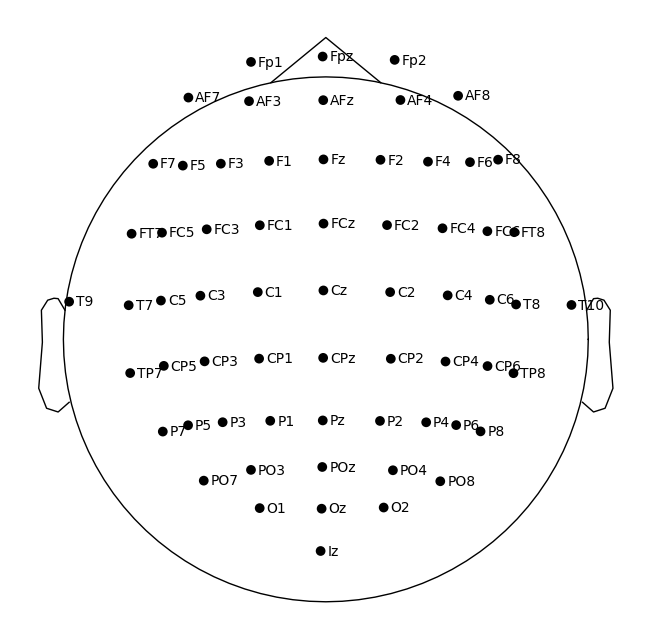

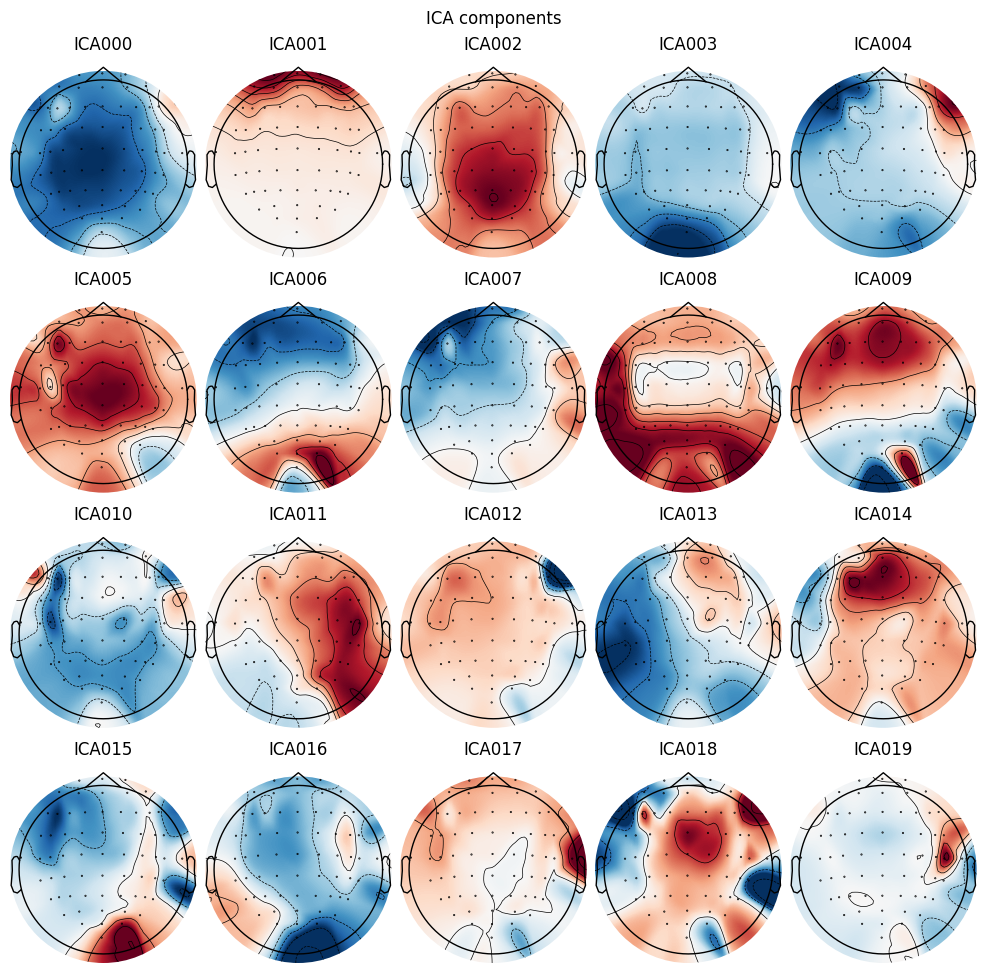

Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 2 ICA components
    Projecting back using 64 PCA components


Measurement date,"August 12, 2009 16:15:00 GMT"
Experimenter,Unknown
Participant,X
Digitized points,67 points
Good channels,64 EEG
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,160.00 Hz
Highpass,0.00 Hz
Lowpass,80.00 Hz


In [5]:
from mne.preprocessing import ICA
# Set up and fit the ICA
ica = ICA(n_components=20, random_state=97, max_iter=800)
ica.fit(raw)

#Set the montage for the dataset
montage = mne.channels.make_standard_montage('standard_1020')
raw.set_montage(montage)

raw.plot_sensors(show_names=True)
# Plot the ICA components to visually identify artifact components
ica.plot_components()

# Once you've identified components that represent artifacts, you can exclude them
# Example: Assuming components 0 and 1 are artifacts
ica.exclude = [0, 1]

# Apply the ICA solution to the Raw data, effectively removing the artifacts
ica.apply(raw)

# Optional: Save the cleaned data to a new file
# raw.save('/mnt/data/S001R01_cleaned.edf', overwrite=True)

Segmentation: If necessary, segment the continuous EEG data into epochs centered around specific events for event-related potential (ERP) analysis.

Segmenting continuous EEG data into epochs centered around specific events is a crucial step for event-related potential (ERP) analysis. This process involves cutting the continuous EEG signal into shorter segments, typically time-locked to specific events (e.g., stimuli onset), allowing for the examination of brain responses to these events.

The following Python code snippet demonstrates how to perform this segmentation using MNE-Python. This example assumes you have already loaded your EEG data into an mne.io.Raw object and that your data includes event markers. If your data does not include event markers, you would need to add them based on your experimental design.

In [6]:
# Step 1: Identify or Create Events
#First, you need to extract or define the events within your EEG data. Events are typically marked during the recording, but if not, you may need to manually identify or import them.
# Define your events array manually or based on external data
import numpy as np
import matplotlib.pyplot as plt
import struct


# Path to the event file
event_file_path = '../EEG/dataset/eeg-motor-movementimagery-dataset-1.0.0/files/S001/S001R01.edf.event'




# Read binary event data
with open(event_file_path, 'rb') as file:
    content = file.read()

# Decode event data
decoded_events = []
for i in range(0, len(content) - len(content) % 8, 8):
    timestamp, event_id = struct.unpack('ii', content[i:i+8])
    decoded_events.append((timestamp, event_id))




In [7]:

# Assuming `decoded_events` is a list of tuples (timestamp, event_id) and timestamps are in seconds
sfreq = raw.info['sfreq']  # Sampling frequency

# Recreate the events array with corrected timestamps
events = np.array([[int(timestamp * sfreq), 0, event_id] for timestamp, event_id in decoded_events if 0 <= timestamp * sfreq < len(raw.times)], dtype=int)

# Check if events array is not empty and is 2-dimensional before sorting
if events.size > 0 and events.ndim > 1:
    events = events[events[:, 0].argsort()]  # Sort events by sample index
else:
    print("No valid events to sort or events array is not 2-dimensional.")

# Proceed only if there are valid events
if events.size > 0:
    # Create epochs again
    epochs = mne.Epochs(raw, events=events, event_id=None, tmin=tmin, tmax=tmax, preload=True, baseline=(None, 0), reject=None)
else:
    print("No valid events found. Check your event extraction process.")


for drop_log in epochs.drop_log:
    print(drop_log)

epochs.plot_drop_log()

epochs = mne.Epochs(raw, events=events, event_id=None, tmin=tmin, tmax=tmax, preload=True, baseline=(None, 0), reject=None)

# Plot epochs
epochs.plot()

# Average epochs to create an Evoked object (ERP)
evoked = epochs.average()

# Plot the ERP
evoked.plot()


No valid events to sort or events array is not 2-dimensional.
No valid events found. Check your event extraction process.


NameError: name 'epochs' is not defined

Visualization Techniques

Using matplotlib as 2D backend.


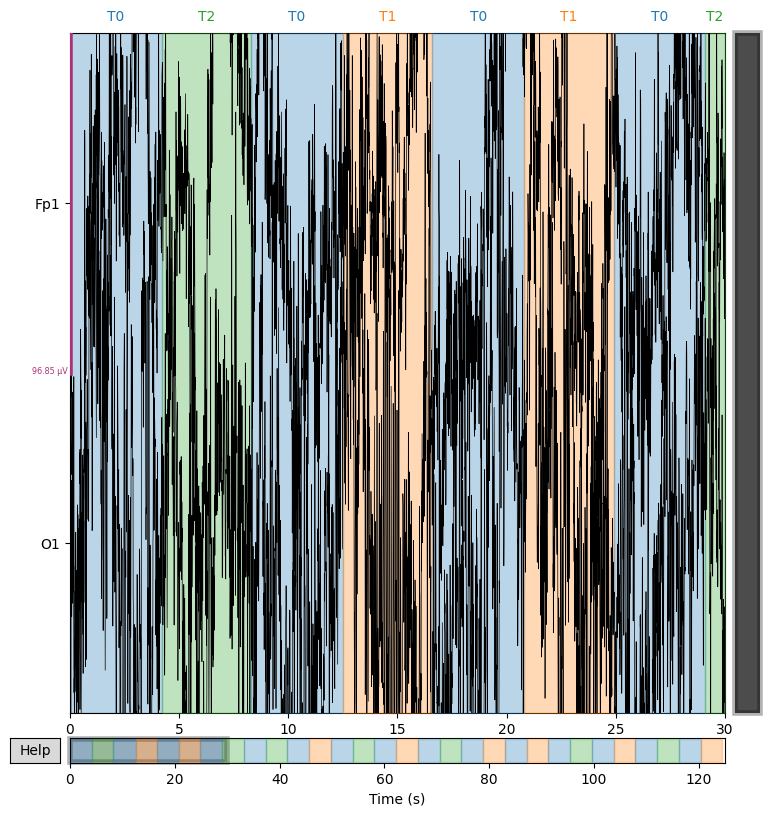

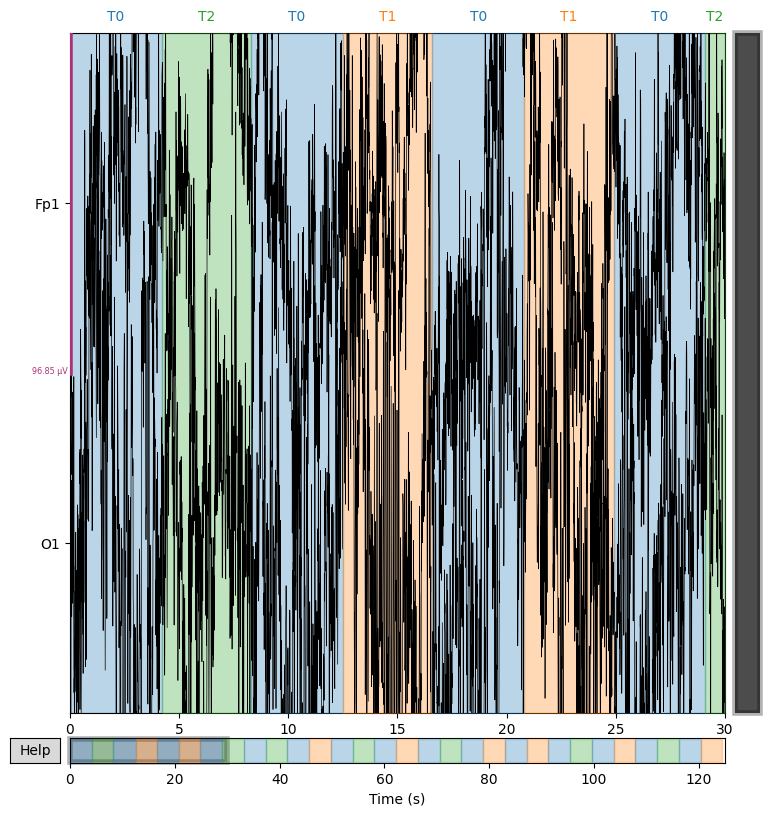

In [8]:
# Specify the channels of interest
channels_of_interest = ['Fp1',  'O1']

# Find the index of the channels of interest
channel_indexes = [raw.ch_names.index(ch) for ch in channels_of_interest if ch in raw.ch_names]

# Use select option to choose channels
raw.plot(order=channel_indexes, start=0, duration=30, scalings='auto', title='Time-Series Data for Fp1/Fp2 and O1/O2')


In [9]:
import plotly.graph_objects as go
import numpy as np

# Assuming 'times' is a 1D array of time points and 'data' is the EEG data for a specific channel
fig = go.Figure()
fig.add_trace(go.Scatter(x=times, y=data, mode='lines', name='Channel Name'))
fig.update_layout(title='EEG Data Over Time', xaxis_title='Time (s)', yaxis_title='Amplitude (µV)')
fig.show()




Initializing animation...
Initializing animation...


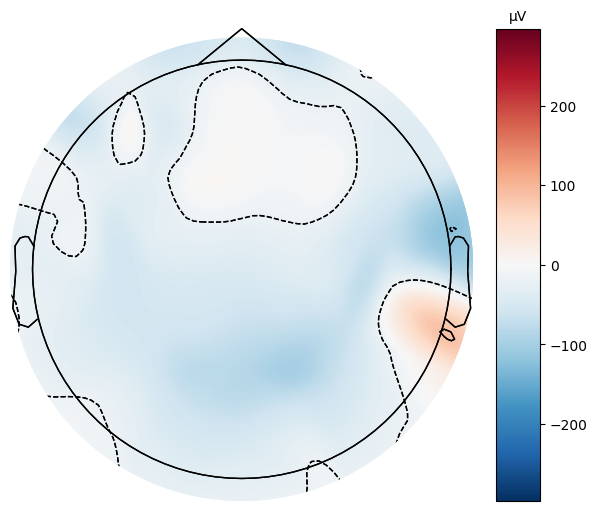

In [10]:
# Assuming you have loaded your EEG data into a 'raw' object
import matplotlib.pyplot as plt 

# Define the parameters for your animation
start = 0.1  # Start time
stop = 0.5   # Stop time
num_frames = 10  # Number of frames

# Create an array of times for the animation
times = np.linspace(start, stop, num_frames)

# Extract the data and info from the 'raw' object
data, times = raw[:, :]
info = raw.info

# Create an Evoked object from your data and info
evoked = mne.EvokedArray(data, info, tmin=times[0], nave=len(times))

# Create and display the animation
evoked.animate_topomap(times=times, ch_type='eeg', time_unit='s')
plt.show()

NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 12.800 (s)


C:\Users\sanji\AppData\Roaming\Python\Python311\site-packages\mne\viz\utils.py:165: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



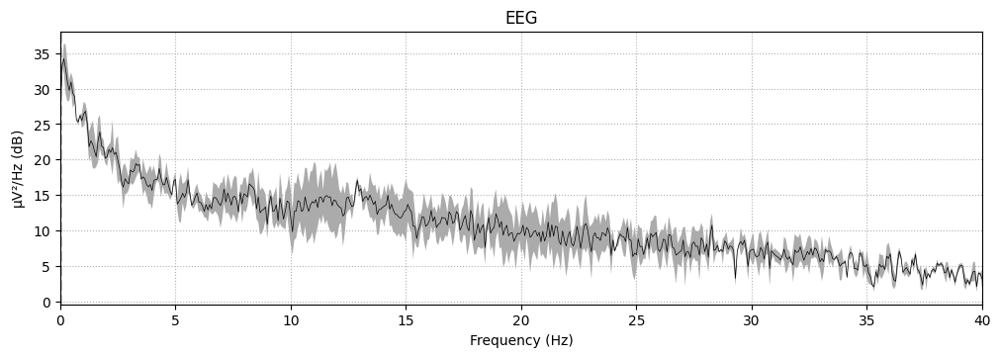

In [23]:
import matplotlib
%matplotlib inline
from IPython.display import display

# Assuming 'raw' is your EEG dataset loaded into an MNE Raw object

# Define parameters for the PSD plot
fmax = 40  # Limit the frequency range to 40 Hz
picks = ['Fp1', 'O1']  # Specify the channels you are interested in

# Use the built-in plot_psd method for a simple and direct PSD visualization
raw.plot_psd(fmax=fmax, picks=picks, average=True)

plt.show()

In [24]:
from scipy.signal import spectrogram
import matplotlib.pyplot as plt

# Define the channels of interest (Fp1 and O1)
channels_of_interest = ['Fp1', 'O1']

# Pick the channels of interest from the epoched data
epochs.pick_channels(channels_of_interest)

# Get the data for the selected channels
data, times = epochs.get_data(return_times=True)

# Set the sampling frequency (you may need to adjust this)
sfreq = epochs.info['sfreq']

# Compute the spectrogram for each channel
plt.figure(figsize=(12, 6))
for i, channel_name in enumerate(channels_of_interest):
    f, t, Sxx = spectrogram(data[i], fs=sfreq)
    plt.subplot(2, 1, i+1)
    plt.pcolormesh(t, f, 10 * np.log10(Sxx), shading='auto', cmap='inferno')
    plt.title(channel_name)
    plt.ylabel('Frequency (Hz)')
    plt.xlabel('Time (s)')
    plt.colorbar(label='Power Spectral Density (dB/Hz)')

plt.tight_layout()
plt.show()

NameError: name 'epochs' is not defined

d:\installedSoftware\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

d:\installedSoftware\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

d:\installedSoftware\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

d:\installedSoftware\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead

d:\installedSoftware\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning:

is_categorical_dtype is deprecated and will b

<Axes: >

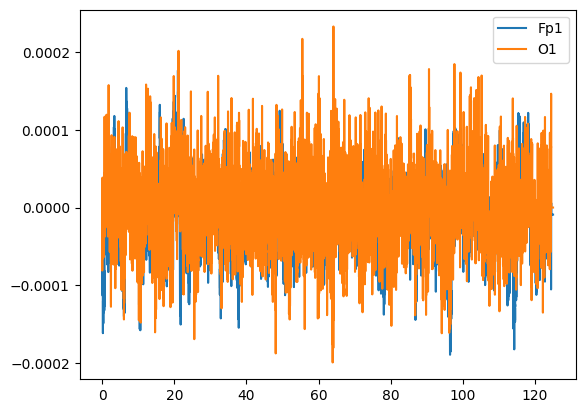

In [25]:
import seaborn as sns

# Transpose 'data' to match the expected shape (20000, 64)
data_transposed = data.T  # Now 'data_transposed' has shape (20000, 64)

# Create the DataFrame
df = pd.DataFrame(data=data_transposed, columns=raw.ch_names, index=times)


# Plot using Seaborn
sns.lineplot(data=df[['Fp1',  'O1']], dashes=False)

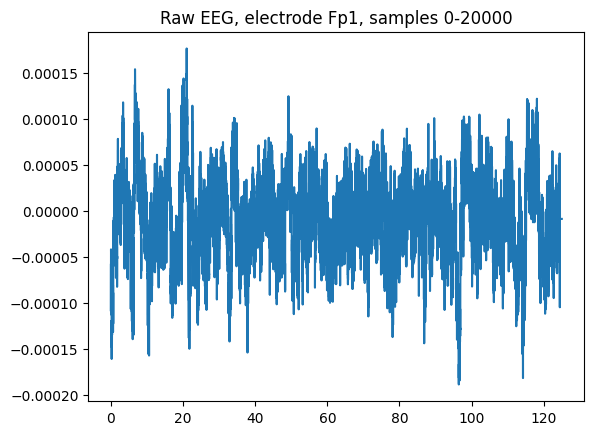

In [30]:
import matplotlib.pyplot as plt

# Assuming 'Fc5.' is the correct column name. If it's 'Fc5', use 'Fc5' instead.
plt.plot(df['Fp1'][:])
plt.title("Raw EEG, electrode Fp1, samples 0-20000")
plt.show()

In [31]:
df['O1'].head(5)

0.00000   -0.000066
0.00625   -0.000034
0.01250   -0.000021
0.01875   -0.000049
0.02500   -0.000069
Name: O1, dtype: float64

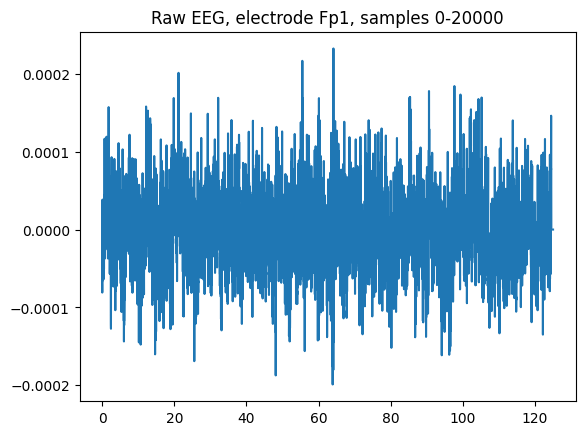

In [32]:
# Assuming 'Fc5.' is the correct column name. If it's 'Fc5', use 'Fc5' instead.
plt.plot(df['O1'][:])
plt.title("Raw EEG, electrode Fp1, samples 0-20000")
plt.show()

Feature Extraction: Calculate the alpha power for the selected electrodes using spectral analysis methods like FFT.

In [65]:
#Select Channels
picks = mne.pick_channels(raw.info['ch_names'], include=['Fp1', 'O1'])
#Extract Data
data, times = raw.get_data(picks=picks, return_times=True)
#Apply FFT
# Initialize an array to store alpha power values
alpha_power = np.zeros(len(picks))

# Sampling frequency
sfreq = raw.info['sfreq']

for i, channel_data in enumerate(data):
    # Compute FFT
    fft_vals = np.fft.rfft(channel_data)
    fft_freq = np.fft.rfftfreq(channel_data.size, d=1./sfreq)

    # Find indices corresponding to alpha band
    alpha_indices = np.where((fft_freq >= 8) & (fft_freq <= 12))[0]

    # Calculate alpha power (using magnitude squared)
    alpha_power[i] = np.mean(np.abs(fft_vals[alpha_indices])**2)


alpha_power

array([4.45832553e-05, 1.14628563e-04])

In [69]:
# Placeholder for alpha power calculation
# You should replace this with your actual calculation
alpha_power_values = alpha_power


# Applying a standard montage if not already applied
montage = mne.channels.make_standard_montage('standard_1020')
raw.set_montage(montage)

# Extracting positions for the selected channels
pos = {ch: montage.get_positions()['ch_pos'][ch] for ch in picks if ch in montage.get_positions()['ch_pos']}
pos_array = np.array([list(pos[ch][:2]) for ch in pos])  # Convert positions to an array


# Validation
print("Alpha power values shape:", alpha_power_values.shape)
print("Position array shape:", pos_array.shape)

# Ensure they are aligned
assert len(alpha_power_values) == pos_array.shape[0], "Mismatch between data and positions."


# Plotting
fig, ax = plt.subplots()
mne.viz.plot_topomap(alpha_power_values, pos_array, axes=ax, cmap='viridis', sensors=True)
plt.show()

Alpha power values shape: (2,)
Position array shape: (0,)


AssertionError: Mismatch between data and positions.